### 1. Tratamento dos dados 
#### 1.1 Importação dos dados e das bibliotecas necessárias

In [108]:
# importar as bibliotecas necessárias
import zipfile
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
from textblob import TextBlob
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from wordcloud import WordCloud
from PIL import Image
import matplotlib.pyplot as plt
import folium
from geopy.geocoders import Nominatim
from shiny.express import input, render, ui
from folium.plugins import HeatMap
import geopandas as gpd
from shapely.geometry import Point, Polygon, shape
import json
import requests
from math import radians, sin, cos, sqrt, atan2
import ipywidgets as widgets
from IPython.display import display
from folium.plugins import HeatMap


In [2]:
# Obter os dados
customers = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/olist_customers_dataset.csv")
geolocation = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/olist_geolocation_dataset.csv")
orders = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/olist_orders_dataset.csv")
order_items = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/olist_order_items_dataset.csv")
order_payments = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/olist_order_payments_dataset.csv")
order_reviews = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/olist_order_reviews_dataset.csv")
products = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/olist_products_dataset.csv")
sellers = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/olist_sellers_dataset.csv")
info_comunidades = pd.read_csv("https://github.com/fshirahige/deploy_dataviz/raw/main/Limite_Favelas_2019.csv")
geojson_comunidades = requests.get("https://github.com/fshirahige/deploy_dataviz/raw/main/Limite_Favelas_2019.geojson").json()


#### 1.2 Agrupar todas as diferentes latitudes e longitudes que um determinado CEP possui para um valor unico por CEP no DF geolocation

In [3]:
# Agrupar todas as diferentes latitudes e longitudes que um determinado CEP possui para um valor unico por CEP
geolocation_agrupado = geolocation.groupby('geolocation_zip_code_prefix').agg({'geolocation_lat':'mean', 'geolocation_lng':'mean'}).reset_index()
geolocation_agrupado.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
0,1001,-23.550190,-46.634024
1,1002,-23.548146,-46.634979
2,1003,-23.548994,-46.635731
3,1004,-23.549799,-46.634757
4,1005,-23.549456,-46.636733


#### 1.3 Transformar as colunas de datas e calcular os prazos de entrega

In [4]:
# Transformando as colunas de data (de object para data)
orders['order_purchase_timestamp'] = pd.to_datetime(orders['order_purchase_timestamp'])
orders['order_estimated_delivery_date'] = pd.to_datetime(orders['order_estimated_delivery_date'])
orders['order_delivered_customer_date'] = pd.to_datetime(orders['order_delivered_customer_date'])
orders['order_approved_at'] = pd.to_datetime(orders['order_approved_at'])
orders['order_delivered_carrier_date'] = pd.to_datetime(orders['order_delivered_carrier_date'])

orders['prazo_estimado'] = (orders['order_estimated_delivery_date'] - orders['order_approved_at']).dt.days
orders['prazo_realizado'] = (orders['order_delivered_customer_date'] - orders['order_approved_at']).dt.days
orders['atraso'] = (orders['order_delivered_customer_date'] - orders['order_estimated_delivery_date']).dt.days

#Calculando o prazo médio de entrega
print(f"Prazo estimado médio: {orders.prazo_estimado.mean()}")
print(f"Prazo realizado médio: {orders.prazo_realizado.mean()}")
print(f"Atraso médio: {orders.atraso.mean()}")

Prazo estimado médio: 22.886262225400632
Prazo realizado médio: 11.642968215463084
Atraso médio: -11.876881296902857


#### 1.4 Criando o df com todas as tabelas

In [5]:
# Mesclar os dataframes
#Mesclando os df de orders e customers
df = pd.merge(orders, customers, on='customer_id', how='inner')
#Mesclando os df de orders e items
df = pd.merge(df, order_items, on='order_id', how='inner')
#Mesclando os df de orders e sellers
df = pd.merge(df, sellers, on='seller_id', how='inner')
#Mesclando os df de orders e payments
df = pd.merge(df, order_payments, on='order_id', how='inner')
#Mesclando os df de orders e reviews
df = pd.merge(df, order_reviews, on='order_id', how='inner')
#Mesclando os df de orders e products
df = pd.merge(df, products, on='product_id', how='inner')
#Mesclando os df de orders e geolocation (customer = geolocation_zip_code_prefix_x)
df = pd.merge(df, geolocation_agrupado, left_on='customer_zip_code_prefix', right_on='geolocation_zip_code_prefix' , how='inner')
#Mesclando os df de orders e geolocation (seller = geolocation_zip_code_prefix_y)
df = pd.merge(df, geolocation_agrupado, left_on='seller_zip_code_prefix', right_on='geolocation_zip_code_prefix' , how='inner')

In [6]:
#Trocar o nome das colunas 'geolocation_zip_code_prefix_x', 'geolocation_lat_x', 'geolocation_lng_x', 'geolocation_zip_code_prefix_y','geolocation_lat_y', 'geolocation_lng_y'
df.rename(columns={'geolocation_zip_code_prefix_x':'geolocation_zip_code_prefix_customer', 'geolocation_lat_x':'geolocation_lat_customer', 'geolocation_lng_x':'geolocation_lng_customer', 'geolocation_zip_code_prefix_y':'geolocation_zip_code_prefix_seller', 'geolocation_lat_y':'geolocation_lat_seller', 'geolocation_lng_y':'geolocation_lng_seller'}, inplace=True)
df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'prazo_estimado', 'prazo_realizado', 'atraso', 'customer_unique_id',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'seller_zip_code_prefix', 'seller_city',
       'seller_state', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'review_id', 'review_score',
       'review_comment_title', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'geolocation_zip_code_prefix_cus

### 2. A Balança Comercial Fluminense: definindo a oportunidade de negócio

In [7]:
# Qual é o valor das vendas (Payment_value) cuja origem é SP (seller_state)? Mostre em reais e em %
total_vendas_sp = df[df['seller_state'] == 'SP']['payment_value'].sum()
total_vendas = df['payment_value'].sum()
percentual_vendas_sp = total_vendas_sp / total_vendas * 100
print(f"Total de vendas de SP: R$ {total_vendas_sp:.2f} ({percentual_vendas_sp:.2f}%)") 


Total de vendas de SP: R$ 13226415.67 (65.83%)


In [8]:
# Qual é o valor das vendas (Payment_value) para é SP (seller_state)? Mostre em reais e em %
total_vendas_para_sp = df[df['customer_state'] == 'SP']['payment_value'].sum()
percentual_vendas_sp = total_vendas_para_sp / total_vendas * 100
print(f"Total de vendas para SP: R$ {total_vendas_para_sp:.2f} ({percentual_vendas_sp:.2f}%)") 

Total de vendas para SP: R$ 7585902.45 (37.76%)


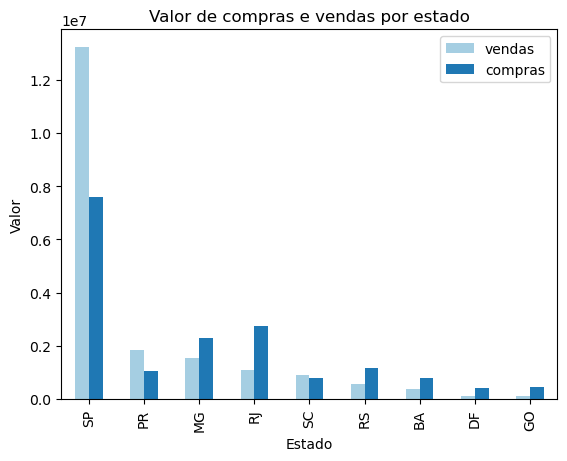

In [9]:
#Fazer um gráfico de barras com o total de vendas e compras por estado no mesmo gráfico. Mostrar somente os dados dos 10 estados com mais vendas
top_10_estados_vendas = df.groupby('seller_state').agg({'payment_value':'sum'}).sort_values(by='payment_value', ascending=False).head(10)
top_10_estados_compras = df.groupby('customer_state').agg({'payment_value':'sum'}).sort_values(by='payment_value', ascending=False).head(10)

#mesclar os dois dataframes
top_10_estados = pd.merge(top_10_estados_vendas, top_10_estados_compras, left_index=True, right_index=True)

#Transformar o index em coluna
top_10_estados.reset_index(inplace=True)

#Renomeando as columns
top_10_estados.rename(columns={'payment_value_x':'vendas', 'payment_value_y':'compras', 'index':'estado'}, inplace=True)

cores = ['#a5cee2','#1f78b4']

# Grafico com a quantidade de compras e vendas por estado do df_compra_venda
fig, ax = plt.subplots()
top_10_estados.plot(kind='bar', x='estado' , y=['vendas', 'compras'], ax=ax, color=cores)
ax.set_ylabel('Valor')
ax.set_xlabel('Estado')
ax.set_title('Valor de compras e vendas por estado')
plt.show()

In [10]:
#Qual a posição do estado de RJ em vendas e compras?
posicao_rj_vendas = top_10_estados_vendas.index.get_loc('RJ') + 1
posicao_rj_compras = top_10_estados_compras.index.get_loc('RJ') + 1
print(f"Posição do RJ em vendas: {posicao_rj_vendas}")
print(f"Posição do RJ em compras: {posicao_rj_compras}")

Posição do RJ em vendas: 4
Posição do RJ em compras: 2


#### 2.1 O RJ na Economia Nacional

In [11]:
# Dados do PIB por estado para o ano de 2018 com siglas
pib = {
    'Estado': [
        'AM', 'RR', 'MT', 'SC', 'RO', 'ES', 'PA', 'MA', 'MS', 'BA', 'AP', 'PI', 
        'TO', 'RS', 'PE', 'RN', 'DF', 'SP', 'CE', 'GO', 'MG', 'PR', 'PB', 'AL', 
        'RJ', 'AC', 'SE'
    ],
    'Valor': [
        100.11, 13.37, 137.44, 298.23, 44.91, 137.02, 161.35, 98.18, 106.97,
        286.24, 16.80, 50.38, 35.67, 457.29, 186.35, 66.97, 254.82, 2210.56,
        155.90, 195.68, 614.88, 440.03, 64.37, 54.41, 758.86, 15.33, 42.02
    ]
}

# Convertendo os dados para um DataFrame do pandas e ordenando
df_pib = pd.DataFrame(pib)
df_pib.sort_values('Valor', ascending=False, inplace=True)

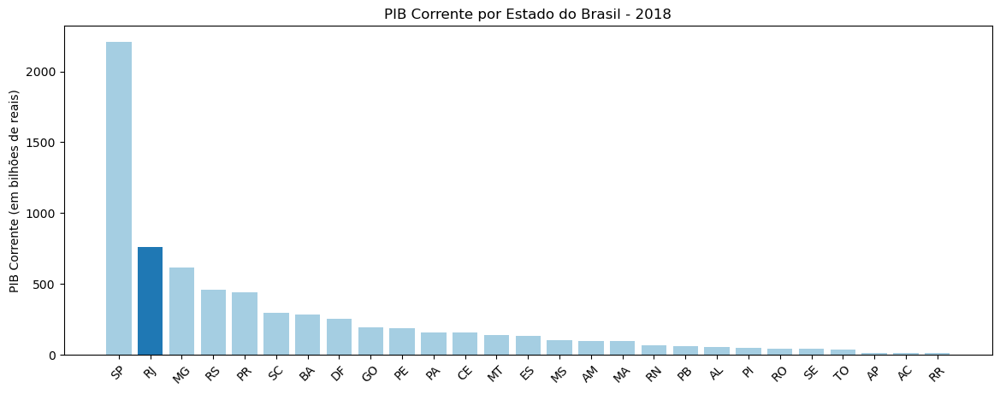

In [12]:

# Definindo as cores para as barras, com a barra do RJ em uma cor diferente
cores = ['#a5cee2' if estado != 'RJ' else '#1f78b4' for estado in df_pib['Estado']]

# Criando o gráfico de barras
plt.figure(figsize=(14, 5))
bars = plt.bar(df_pib['Estado'], df_pib['Valor'], color=cores)
plt.ylabel('PIB Corrente (em bilhões de reais)')
plt.xticks(rotation=45)

# Adicionando os rótulos de valor em cada barra, dividindo por 1000 para converter em trilhões
for bar in bars:
    yval = bar.get_height()
   # plt.text(bar.get_x() + bar.get_width()/2, yval + 5, f'{yval/1000:.2f}', ha='center', va='bottom')

plt.title('PIB Corrente por Estado do Brasil - 2018')
plt.show()

O RJ possui o segundo maior PIB do Brasil, mas é somente  4o. estado que mais vende na base de dados da Olist.

### 3. O Trabalho a Ser Feito
#### 3.1 RJ compra de SP: 70% das vendas feitas no RJ são de SP

In [13]:
# Criar um dataframe com os dados de compras de clientes do RJ
df_rj = df[df['customer_state'] == 'RJ']

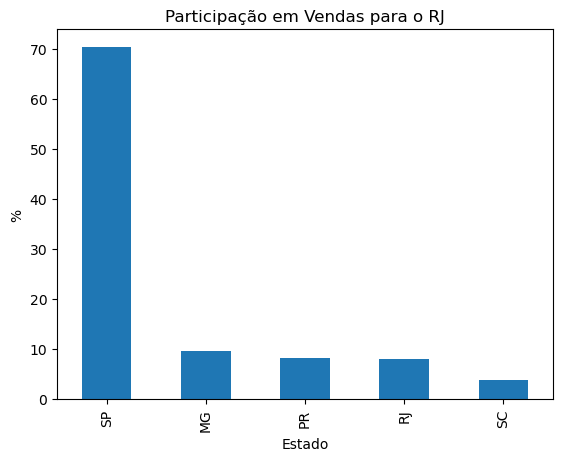

In [14]:
# Grafico de barras com a participação dos estados vendedores no df_rj ordenado do maior para o menor. Colocar um título e um label para o eixo x e eixo y
top_5_estados = df_rj['seller_state'].value_counts().head(5).index
df_rj_top_5 = df_rj[df_rj['seller_state'].isin(top_5_estados)]
estados_vendedores = df_rj_top_5['seller_state'].value_counts(normalize=True)*100
estados_vendedores.plot(kind='bar')
plt.title('Participação em Vendas para o RJ')
plt.xlabel('Estado')
plt.ylabel('%')
plt.show()

#### 3.2 Melhor experiência do consumidor: apesar ser o estado que mais vende para o RJ, as vendas de SP possuem a pior avaliação

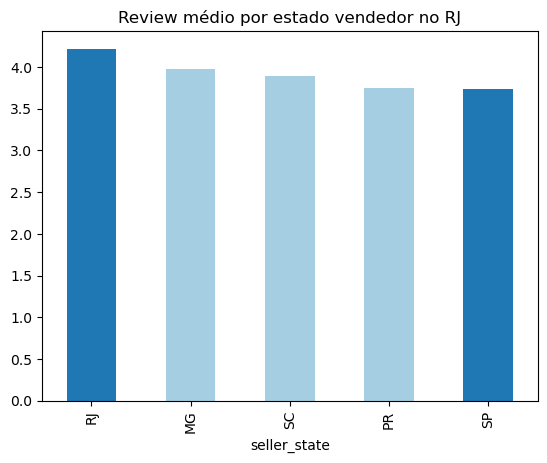

In [15]:
df_rj = df[df['customer_state'] == 'RJ']

top_5_estados = df_rj['seller_state'].value_counts().head(5).index
df_rj_top_5 = df_rj[df_rj['seller_state'].isin(top_5_estados)]

df_grafico_review = df_rj_top_5.groupby('seller_state')['review_score'].mean().sort_values(ascending=False)


df_grafico_review.head()

# Definir a lista de cores
cores = ['#1f78b4', '#1f78b4']

# Selecionar os estados que você deseja colorir
estados_selecionados = ['SP', 'RJ']

# Mapear as cores para os estados
mapa_cores = dict(zip(estados_selecionados, cores))

df_grafico_review.plot(kind='bar',
                     color=[mapa_cores.get(estado,'#a5cee2')
                            for estado 
                            in df_grafico_review.index])

plt.title('Review médio por estado vendedor no RJ')
plt.show()

#### 3.3 Melhor experiência do consumidor: 1 em cada 5 vendas de SP para RJ são ruins (nota 1)

C:\Users\fidel\AppData\Local\Temp\ipykernel_28572\1320251697.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rj['review_score_1'] = np.where(df_rj['review_score'] == 1, 1, 0)


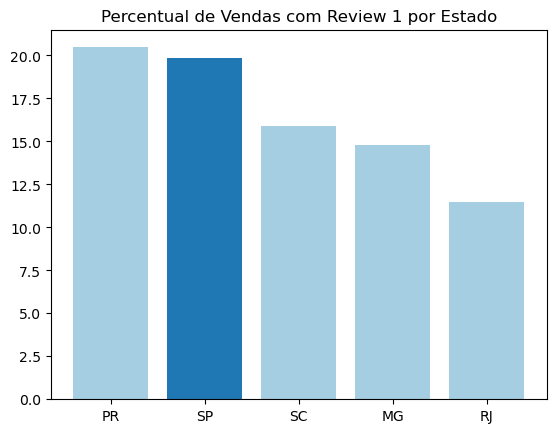

In [16]:
# Grafico com Percentual das vendas com reviews de nota 1 por estados no df_rj. Considerar somente os top 5 estados com mais vendas. Destacar a barra do estado de SP com uma cor diferente
df_rj['review_score_1'] = np.where(df_rj['review_score'] == 1, 1, 0)
df_rj.groupby('customer_state')['review_score_1'].mean().sort_values(ascending=False)

top_5_estados = df_rj['seller_state'].value_counts().head(5).index
df_rj_top_5 = df_rj[df_rj['seller_state'].isin(top_5_estados)]
review_1_estado = df_rj_top_5.groupby('seller_state')['review_score_1'].mean().sort_values(ascending=False)*100

plt.bar(review_1_estado.index, review_1_estado.values, color='#a5cee2' )

indice_destacado =  review_1_estado.index.get_loc('SP')
cores = ['#a5cee2'  if i != indice_destacado else '#1f78b4' for i in range(len(review_1_estado.index))]
plt.bar(review_1_estado.index[indice_destacado], review_1_estado.values[indice_destacado], color=cores[indice_destacado])
plt.title('Percentual de Vendas com Review 1 por Estado')

plt.show()

#### 3.4 Entregas de SP atrasam mais: 12% das entregas de SP para RJ atrasam

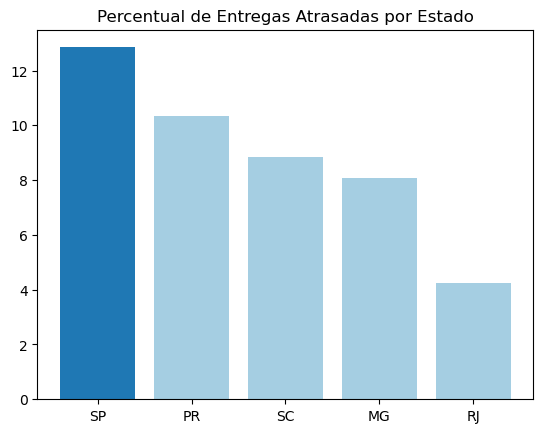

In [17]:
# Grafico com o percentual de atraso maior do que 0 em relação ao total de vendas por estado de origem no df_rj, ordenado do maior para o menor. Considere somente os top 5 estados que mais vendem
top_5_estados = df_rj['seller_state'].value_counts().head(5).index
df_rj_top_5 = df_rj[df_rj['seller_state'].isin(top_5_estados)]
atraso_estado = df_rj_top_5[df_rj_top_5['atraso'] > 0]['seller_state'].value_counts()/df_rj_top_5['seller_state'].value_counts()*100
atraso_estado = atraso_estado.sort_values(ascending=False)

plt.bar(atraso_estado.index, atraso_estado.values, color='#a5cee2')

indice_destacado =  atraso_estado.index.get_loc('SP')

cores = ['#a5cee2' if i != indice_destacado else '#1f78b4' for i in range(len(atraso_estado.index))]
plt.bar(atraso_estado.index[indice_destacado], atraso_estado.values[indice_destacado], color=cores[indice_destacado])
plt.title('Percentual de Entregas Atrasadas por Estado')

plt.show()

#### 3.5  Potencial redução no preço pelo frete: o custo do frete no RJ é 20% menor do que em SP

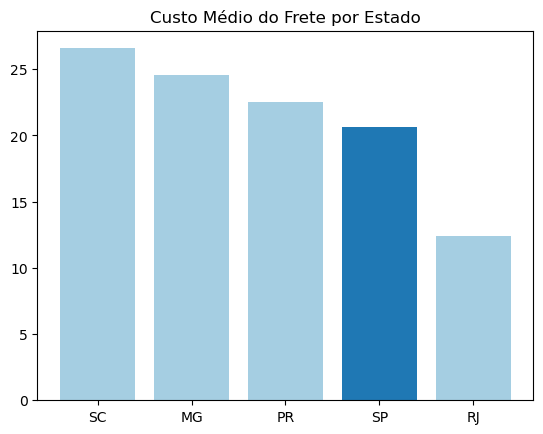

In [18]:
# Faça o gráfico do custo médio do frete por estado no df_rj. Considere o top 5 estados com maior valor de vendas
top_5_estados = df_rj['seller_state'].value_counts().head(5).index
df_rj_top_5 = df_rj[df_rj['seller_state'].isin(top_5_estados)]
frete_estado = df_rj_top_5.groupby('seller_state')['freight_value'].mean().sort_values(ascending=False)
frete_estado = frete_estado.sort_values(ascending=False)


plt.bar(frete_estado.index, frete_estado.values, color='#a5cee2')


indice_destacado =  frete_estado.index.get_loc('SP')
#cores = ['#a5cee2' if i != indice_destacado else '#1f78b4' for i in range(len(frete_estado.index))]
cores = ['#1f78b4', '#1f78b4']
plt.bar(frete_estado.index[indice_destacado], frete_estado.values[indice_destacado], color=cores)
#[indice_destacado])
plt.title('Custo Médio do Frete por Estado')


plt.show()

#### 3.6 Principais categorias vendidas no RJ

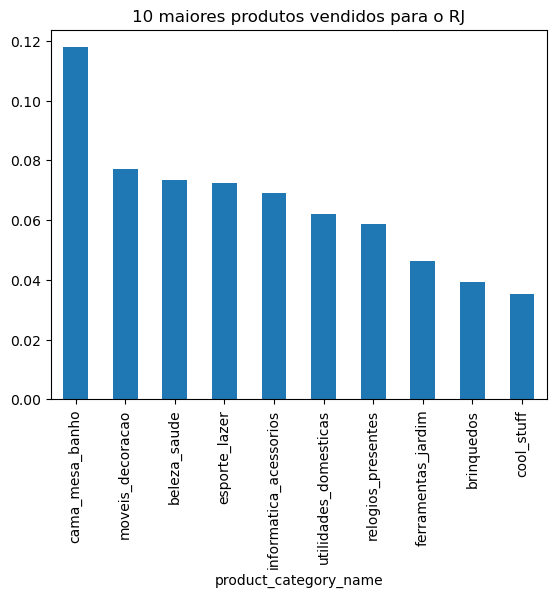

In [19]:
#Grafico com a participação dos 10 maiores produtos vendidos para o RJ com titulo
df_rj['product_category_name'].value_counts(normalize=True).head(10).plot(kind='bar')
plt.title('10 maiores produtos vendidos para o RJ')
plt.show()

#### 3.7 Principais categorias entre RJ e SP

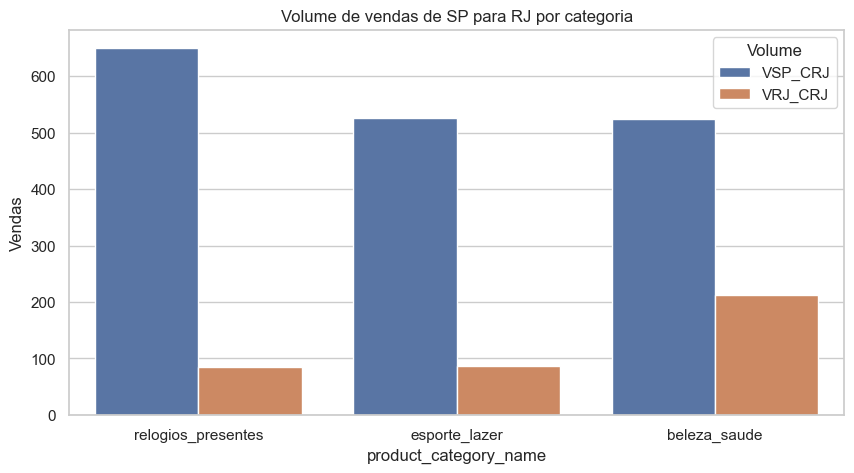

In [20]:
#Volume de VENDAS de RJ para Brasil POR CATEGORIA TOP_5
VRJ = df[(df['seller_state'] == 'RJ')].groupby('product_category_name')['order_id'].nunique().sort_values(ascending=False).head(5)

#Volume de VENDAS de SP para RJ POR CATEGORIA TOP_5
VSP_CRJ = df[(df['seller_state'] == 'SP') & (df['customer_state'] == 'RJ')].groupby('product_category_name')['order_id'].nunique().sort_values(ascending=False).head(5)

#Categorias vendidas pelos vendedores do RJ para os clientes do RJ
VRJ_CRJ = df[(df['seller_state'] == 'RJ') & (df['customer_state'] == 'RJ')].groupby('product_category_name')['order_id'].nunique().sort_values(ascending=False).head(5)

#Unir os 2 dataframes removendo categorias com volume nulo
VSP_CRJ = VSP_CRJ.reset_index()
VRJ_CRJ = VRJ_CRJ.reset_index()
VSP_CRJ = VSP_CRJ.merge(VRJ_CRJ, on='product_category_name', how='inner')
VSP_CRJ.columns = ['product_category_name', 'VSP_CRJ', 'VRJ_CRJ']
#VSP_CRJ
#plotar gráfico barras VSP_CRJ
#VSP_CRJ.plot(x='product_category_name', y=['VSP_CRJ', 'VRJ_CRJ'], kind='bar', figsize=(10, 5))
#plt.title('Volume de vendas de SP para RJ por categoria')
#plt.show()

#Plotar a base VSP_CRJ utilizando seaborn
sns.set(style="whitegrid")
VSP_CRJ = VSP_CRJ.melt('product_category_name', var_name='Volume', value_name='Vendas')
plt.figure(figsize=(10, 5))
sns.barplot(x='product_category_name', y='Vendas', hue='Volume', data=VSP_CRJ)
plt.title('Volume de vendas de SP para RJ por categoria')
plt.show()

#### 3.8 Preço médio de produtos mais vendidos é maior em SP

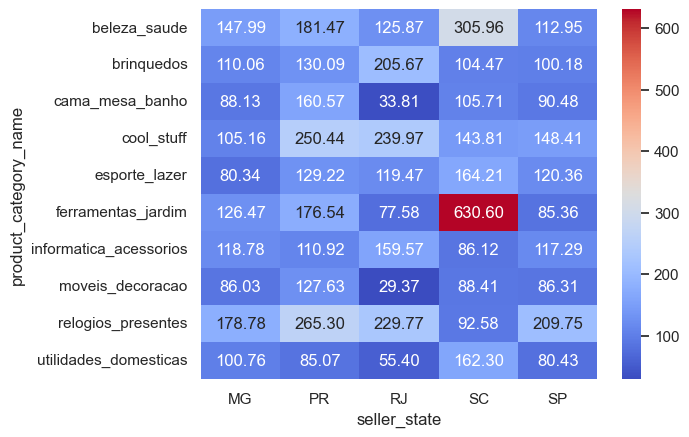

In [21]:
# Calcule o preço medio por produto e por estado dos top 10 produtos mais vendidos e dos top 3 estados vendedores no df_rj e plote numa matrix de calor
top_10_produtos = df_rj['product_category_name'].value_counts().head(10).index
top_5_estados = df_rj['seller_state'].value_counts().head(5).index
df_rj_top_10 = df_rj[df_rj['product_category_name'].isin(top_10_produtos)]
df_rj_top_10 = df_rj_top_10[df_rj_top_10['seller_state'].isin(top_5_estados)]
preco_medio = df_rj_top_10.groupby(['product_category_name', 'seller_state'])['price'].mean().unstack()
sns.heatmap(preco_medio, annot=True, fmt=".2f", cmap='coolwarm')
plt.show()

### 4. Proposta
Vemos uma oportunidade de estimular a oferta de produtos de vendedores locais no RJ, visando aumentar a satisfação dos clientes no estado

### 5. Análise geoespacial das compras na cidade do RJ

#### 5.1 Análise da quantidade de produtos comprados no RJ

In [ ]:
#Filtar os NaN das colunas de geolocation_lat e geolocation_lng
df_rj_filtered = df_rj.dropna(subset=['geolocation_lat_customer', 'geolocation_lng_customer'])

# Filtrar o CEP entre 23799-23999
df_rj_filtered = df_rj_filtered[(df_rj['customer_zip_code_prefix'] >= 20000) & (df_rj['customer_zip_code_prefix'] <= 23799)]

In [220]:
# Mapa com as locais para onde foram vendidos os produtos da Olist
#Plotar no mapa do Rio de Janeiro a quantidade de vendas

# Mapa com as locais para onde foram vendidos os produtos da Olist . O tamanho das bolas representam a quantidade de vendas

# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.33511], tiles="Cartodb Positron", zoom_start=11)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)

# Agrupar as vendas por latitude e longitude e contar o número de vendas em cada localização
vendas_por_localizacao = df_rj_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer']).size().reset_index(name='count')

# Iterar sobre as localizações e adicionar círculos ao mapa, onde o tamanho do círculo representa a quantidade de vendas
for index, row in vendas_por_localizacao.iterrows():
    folium.CircleMarker(
        location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
        radius=row['count']/10,  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
        color='blue',
        fill=True,
        fill_color='blue'
    ).add_to(rio_map)

# Salvar o mapa como um arquivo HTML
rio_map


#### 5.2 Análise do Valor das Vendas no RJ

In [219]:
# Mapa com as locais para onde foram vendidos os produtos da Olist . O tamanho das bolas representam o valor das vendas

# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.33511], tiles="Cartodb Positron", zoom_start=11)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)

# Agrupar as vendas por latitude e longitude e somar o valor das vendas em cada localização
valor_por_localizacao = df_rj_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer'])['payment_value'].sum().reset_index(name='total_valor_vendas')

# Iterar sobre as localizações e adicionar círculos ao mapa, onde o tamanho do círculo representa a quantidade de vendas
for index, row in valor_por_localizacao.iterrows():
    folium.CircleMarker(
        location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
        radius=row['total_valor_vendas']/1000,  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
        color='blue',
        fill=True,
        fill_color='blue'
    ).add_to(rio_map)

# Salvar o mapa como um arquivo HTML
rio_map

#### 5.3 Análise da Origem dos Produtos Vendidos no RJ (SP vs. Demais Estados)

In [218]:
# Mapa com as locais para onde foram vendidos os produtos da Olist . O tamanho das bolas representam a quantidade de vendas. Verde representa SP e Azul, RJ.

# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.33511], tiles="Cartodb Positron", zoom_start=11)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)

# Agrupar as vendas por latitude e longitude e contar o número de vendas em cada localização
vendas_estado = df_rj_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer', 'seller_state']).size().reset_index(name='count')

# Iterar sobre as localizações e adicionar círculos ao mapa, onde o tamanho do círculo representa a quantidade de vendas
for index, row in vendas_estado.iterrows():
    if row['seller_state'] == 'SP':
        # Destacar as vendas de São Paulo com cor verde
        cor = 'green'
    else:
        # Outras vendas em azul
        cor = 'blue'
    folium.CircleMarker(
        location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
        radius=row['count']/10,  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
        color=cor,
        fill=True,
        fill_color=cor
    ).add_to(rio_map)

# Salvar o mapa como um arquivo HTML
rio_map

#### 5.4 Análise das Reviews dos Produtos Vendidos no RJ

In [154]:
# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.1729], tiles="Cartodb Positron", zoom_start=11)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)


# Agrupar as vendas por latitude e longitude e obter a média do review_score
review_por_localizacao = df_rj_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer'])['review_score'].mean().reset_index(name='review')

# Iterar sobre as localizações e adicionar círculos ao mapa, onde o tamanho do círculo representa a quantidade de vendas
for index, row in review_por_localizacao.iterrows():
    if row['review'] > 3:
        # Destacar as vendas de São Paulo com cor verde
        cor = 'blue'
    else:
        # Outras vendas em azul
        cor = 'red'
    folium.CircleMarker(
        location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
        radius=row['review'],  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
        color=cor,
        fill=True,
        fill_color=cor
    ).add_to(rio_map)

# Exibindo o mapa
rio_map


#### 5.5 Análise do Custo do Frete dos Produtos Vendidos no RJ

In [217]:
# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.33511], tiles="Cartodb Positron", zoom_start=11)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)


# Agrupar as vendas por latitude e longitude e pegar o frete médio
frete_por_localizacao = df_rj_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer'])['freight_value'].mean().reset_index(name='frete')

# Calcular o frete médio
frete_medio = frete_por_localizacao['frete'].mean()

# Iterar sobre as localizações e adicionar círculos ao mapa, onde o tamanho do círculo representa a quantidade de vendas
for index, row in frete_por_localizacao.iterrows():
    if row['frete'] > frete_medio:
        # Destacar as vendas de São Paulo com cor verde
        cor = 'red'
    else:
        # Outras vendas em azul
        cor = 'blue'
    folium.CircleMarker(
        location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
        radius=row['frete']/10,  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
        color=cor,
        fill=True,
        fill_color=cor
    ).add_to(rio_map)

# Exibindo o mapa
rio_map

#### 5.6 Análise das Reviews dos Produtos Vendidos no RJ cuja Origem é SP

In [216]:
# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.33511], tiles="Cartodb Positron", zoom_start=11)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)

# Filtar no df_rj_filtered somente os valores de São Paulo
df_rj_sp_filtered = df_rj_filtered[df_rj_filtered['seller_state'] == 'SP']

# Agrupar as vendas por latitude e longitude e obter a média do review_score
review_local_sp = df_rj_sp_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer'])['review_score'].mean().reset_index(name='review')

# Iterar sobre as localizações e adicionar círculos ao mapa, onde o tamanho do círculo representa a quantidade de vendas
for index, row in review_local_sp.iterrows():
    if row['review'] > 3:
        # Destacar as vendas de São Paulo com cor verde
        cor = 'blue'
    else:
        # Outras vendas em azul
        cor = 'red'
    folium.CircleMarker(
        location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
        radius=row['review'],  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
        color=cor,
        fill=True,
        fill_color=cor
    ).add_to(rio_map)

# Exibindo o mapa
rio_map


#### 5.7 Análise das Reviews dos Produtos Vendidos no RJ cuja Origem é SP - Heatpmap

In [213]:
# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.33511], tiles="Cartodb Positron", zoom_start=11.5)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)

# Agrupar as vendas por latitude e longitude e obter a média do review_score
review_local_sp = df_rj_sp_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer'])['review_score'].mean().reset_index(name='review')

# Criar HeatMap com base nos dados
heat_data = [[row['geolocation_lat_customer'], row['geolocation_lng_customer'], row['review']] for index, row in review_local_sp.iterrows()]
heatmap = HeatMap(heat_data, radius=15, gradient={'0':'#FF0000', '0.2':'#FF0000', '0.4':'#FFA500', '0.6':'#FFFF00', '0.8':'#00FF00','1': '#0000FF'})

# Adicionar heatmap ao mapa
rio_map.add_child(heatmap)

legend_html = '''
    <div style="position: fixed; 
                bottom: 50px; left: 50px; width: 60px; height: 150px; 
                background-color: white; border:2px solid grey; z-index:9999;
                font-size:10px; padding: 10px;">
        <strong>Review</strong><br>
        <div style="margin-top:5px; background-color:#FF0000; height:5px;"></div>
        1<br>
        <div style="margin-top:5px; background-color:#FFA500; height:5px;"></div>
        2<br>
        <div style="margin-top:5px; background-color:#FFFF00; height:5px;"></div>
        3<br>
        <div style="margin-top:5px; background-color:#00FF00; height:5px;"></div>
        4<br>
        <div style="margin-top:5px; background-color:#0000FF; height:5px;"></div>
        5<br>
    </div>'''
rio_map.get_root().html.add_child(folium.Element(legend_html))

# Exibir o mapa
rio_map

#### 5.7 Análise das Vendas no RJ - Mapa Interativo

In [210]:
# Criar um dataframe a partir do df_rj_filtered com a latitude e longitude, o valor das vendas, review médio, frete médio e tempo de entrega médio
df_rj_filtered_mapa  = df_rj_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer']).agg({'payment_value':'sum', 'review_score':'mean', 'freight_value':'mean', 'prazo_realizado':'mean'}).reset_index()

#Trocar o nome das colunas 
df_rj_filtered_mapa.columns = ['geolocation_lat_customer', 'geolocation_lng_customer', 'Vendas', 'Review', 'Frete', 'Prazo de Entrega']

# Função para atualizar o mapa com base nas seleções do usuário
def atualizar_mapa(variavel_selecionada):
    # Criar um mapa centrado no Rio de Janeiro
    rio_map = folium.Map(location=[-22.9068, -43.33511], tiles="Cartodb Positron", zoom_start=11)
     
    #Incluir as comunidades no mapa
    folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
    ).add_to(rio_map)
    
    media_variavel = df_rj_filtered_mapa[variavel_selecionada].mean() #calcula a media da variável selecionada

    for index, row in df_rj_filtered_mapa.iterrows():
        if row[variavel_selecionada] > media_variavel:
            cor = 'red'
        else:
            cor = 'blue'
        folium.CircleMarker(
            location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
            radius=5,  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
            color=cor,
            fill=True,
            fill_color=cor
        ).add_to(rio_map)
    
    legend_html = '''
        <div style="position: fixed; 
                    bottom: 50px; left: 50px; width: 100px; height: 80px; 
                    background-color: white; border:2px solid grey; z-index:9999;
                    font-size:10px; padding: 10px;">
            <strong>Legenda</strong><br>
            <div style="margin-top:5px; background-color:#FF0000; height:5px;"></div>
            Acima da Média<br>
            <div style="margin-top:5px; background-color:#0000FF; height:5px;"></div>
            Abaixo da Média<br>
        </div>'''
    rio_map.get_root().html.add_child(folium.Element(legend_html))
    display(rio_map)


# Criar interface de usuário para selecionar variável
variaveis = list(df_rj_filtered_mapa.columns)  # Lista de variáveis disponíveis
variaveis = variaveis[2:]# Remover latitude e longitude da lista de variáveis

selecionar_variavel = widgets.Dropdown(options=variaveis, description='Variável:')

# Conectar a função de atualização à seleção do usuário
widgets.interactive(atualizar_mapa, variavel_selecionada=selecionar_variavel)





interactive(children=(Dropdown(description='Variável:', options=('Vendas', 'Review', 'Frete', 'Prazo de Entreg…

In [169]:
df_rj_filtered_mapa.head()

,geolocation_lat_customer,geolocation_lng_customer,payment_value,review_score,freight_value,prazo_realizado
0,-23.020471,-43.462656,12073.91,3.756098,17.186220,15.077922
1,-23.012987,-43.465520,27913.02,3.913907,20.515166,15.800000
2,-23.010803,-43.309887,6306.50,3.305556,19.849444,23.709677
3,-23.010131,-43.338680,8279.82,3.790698,19.471395,12.860465
4,-23.009475,-43.334530,6945.09,3.568182,22.120000,15.232558


### 6. Análise nas Comunidades do RJ

#### 6.1 Obtendo os CEPs mais próximos de cada comunidade

In [28]:
# Transformar o geojson em um GeoDataFrame
gdf_comunidades = gpd.GeoDataFrame.from_features(geojson_comunidades['features'])

#obter a latitude e longitude média de cada comunidade a partir do centroide do poligono de cada comunidade
gdf_comunidades['latitude'] = gdf_comunidades['geometry'].centroid.y
gdf_comunidades['longitude'] = gdf_comunidades['geometry'].centroid.x

gdf_comunidades.head()

,geometry,objectid,cod_favela,nome,situacao,cod_comple,complexo,data_cadas,cod_bairro,bairro,...,cod_ap,pop_sabren,dom_sabren,fonte,upp,Shape__Area,Shape__Length,sabrengisadminLim_Favelas_2019area,latitude,longitude
0,"POLYGON ((-43.33513 -22.87361, -43.33521 -22.8...",1,927,Comendador Lisboa,1,2053,Grota,2009-01-15T03:00:00Z,83,Madureira,...,3,119,39,IBGE - Censo Demográfico 2010,N,4320.879465,350.780567,4320.879465,-22.873952,-43.334800
1,"POLYGON ((-43.38936 -22.93380, -43.38838 -22.9...",2,926,Parque da Comunidade Vila Arco Íris,1,2092,Colônia Juliano Moreira,2009-01-15T03:00:00Z,115,Jacarepaguá,...,4,404,119,IBGE - Censo Demográfico 2010,N,18062.732520,805.545476,18062.732520,-22.934852,-43.387459
2,"POLYGON ((-43.39954 -22.92021, -43.40006 -22.9...",3,925,Vila Rio Grande,2,0,Isolada,2009-01-15T03:00:00Z,115,Jacarepaguá,...,4,136,42,IBGE - Censo Demográfico 2010,N,8776.701587,400.946770,8776.701587,-22.920687,-43.399985
3,"POLYGON ((-43.39978 -22.93966, -43.39979 -22.9...",4,924,Caminho Novo da Represa,2,0,Isolada,2009-01-15T03:00:00Z,115,Jacarepaguá,...,4,74,24,IPP com base em IBGE - Censo Demográfico 2010,N,8997.763268,602.187479,8997.763268,-22.939528,-43.400771
4,"POLYGON ((-43.42805 -22.92840, -43.42817 -22.9...",5,923,Caminho dos Calharins,2,0,Isolada,2009-01-15T03:00:00Z,115,Jacarepaguá,...,4,110,27,IPP com base em IBGE - Censo Demográfico 2010,N,11867.330967,528.673510,11867.330967,-22.927924,-43.428711


In [29]:
def haversine_distance(lat1, lon1, lat2, lon2):
    """
    Calcula a distância haversine entre dois pontos em coordenadas de latitude e longitude.
    
    Args:
        lat1, lon1: Latitude e longitude do primeiro ponto, em graus decimais.
        lat2, lon2: Latitude e longitude do segundo ponto, em graus decimais.
        
    Returns:
        A distância haversine entre os dois pontos, em quilômetros.
    """
    # Converter graus decimais para radianos
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    
    # Diferença entre as coordenadas
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    
    # Fórmula de Haversine
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    distance = 6371 * c  # Raio da Terra em km
    
    return distance


In [30]:
# Colocar o nome da comunidade das coordenadas mais próximas num raio de 1km dos pontos de vendas (customer_zip_code_prefix) do df_rj
comunidades = [] # Lista para armazenar o nome da comunidade mais próxima
distancia_do_cep= [] # Lista para armazenar a distância da geolocalização do CEP até a o centróide da comunidade mais próxima
for index, row in df_rj.iterrows(): # Iterar sobre as linhas do dataframe df_rj
    lat = row['geolocation_lat_customer']
    lon = row['geolocation_lng_customer']
    distancias = [] # Lista para armazenar as distâncias entre o ponto de venda e os centróides das comunidades
    for index2, row2 in gdf_comunidades.iterrows(): # Iterar sobre as linhas do dataframe gdf_comunidades
        dist = haversine_distance(lat, lon, row2['latitude'], row2['longitude']) # Calcular a distância entre o ponto de venda e o centróide da comunidade
        distancias.append((dist, row2['cod_favela'])) # Adicionar a distância e o nome da comunidade à lista de distâncias
    distancias.sort() # Ordenar a lista de distâncias
    comunidades.append(distancias[0][1]) # Adicionar o nome da comunidade mais próxima à lista de comunidades
    distancia_do_cep.append(distancias[0][0]) # Adicionar a distância da geolocalização do CEP até a o centróide da comunidade mais próxima à lista de distâncias   


df_rj['cod_favela'] = comunidades # Adicionar a lista de comunidades ao dataframe df_rj
df_rj['distancia do CEP'] = distancia_do_cep # Adicionar a lista de distâncias ao dataframe df_rj

df_rj.head()


C:\Users\fidel\AppData\Local\Temp\ipykernel_28572\1451664522.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rj['cod_favela'] = comunidades # Adicionar a lista de comunidades ao dataframe df_rj
C:\Users\fidel\AppData\Local\Temp\ipykernel_28572\1451664522.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rj['distancia do CEP'] = distancia_do_cep # Adicionar a lista de distâncias ao dataframe df_rj


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,prazo_estimado,prazo_realizado,...,product_width_cm,geolocation_zip_code_prefix_customer,geolocation_lat_customer,geolocation_lng_customer,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller,review_score_1,cod_favela,distancia do CEP
10,e37531db8933bdce0f86e9dc3768759e,74380820e581b5e8585abc1b5e11c079,delivered,2017-08-07 21:48:23,2017-08-07 22:25:11,2017-08-08 13:00:00,2017-08-16 11:42:26,2017-08-29,21.0,8.0,...,15.0,21340,-22.871018,-43.356845,9350,-23.680729,-46.444238,0,934,0.404415
47,60d13096e69ace88a0c5b8c3805010ca,54bd7edf8250e9e67794e9df507e3720,delivered,2017-11-06 13:48:10,2017-11-07 07:30:35,2017-11-10 14:24:33,2017-11-18 12:21:41,2017-11-28,20.0,11.0,...,19.0,28016,-21.765592,-41.282021,9350,-23.680729,-46.444238,0,617,217.566995
50,f8b3a190c48ca5261da8494b51c540bd,54ac14c3edc253de071e90f1e541bffc,delivered,2017-11-05 15:56:14,2017-11-05 16:10:28,2017-11-06 19:33:24,2017-11-14 22:59:46,2017-11-28,22.0,9.0,...,34.0,28621,-22.323429,-42.547614,9350,-23.680729,-46.444238,0,617,74.760920
53,0010b2e5201cc5f1ae7e9c6cc8f5bd00,57ef317d4818cb42680fc9dfd13867ce,delivered,2017-09-11 17:39:33,2017-09-11 18:04:37,2017-09-12 17:02:57,2017-09-23 13:21:21,2017-09-27,15.0,11.0,...,34.0,22461,-22.961345,-43.213641,9350,-23.680729,-46.444238,0,25,1.199996
62,6f4e7312027dba2bba5c1b75addfd1ef,db76a08441e64f32ac64a72161893227,delivered,2017-07-19 08:52:47,2017-07-19 22:35:12,2017-07-20 14:49:27,2017-07-27 16:43:34,2017-08-10,21.0,7.0,...,34.0,27945,-22.372457,-41.794318,9350,-23.680729,-46.444238,0,617,141.272406


In [31]:
# Verificar se um ponto está dentro de uma comunidade
dentro_comunidade = [] # Lista para armazenar se o ponto está dentro de uma comunidade
for index, row in df_rj.iterrows():
    point = Point(row['geolocation_lng_customer'], row['geolocation_lat_customer']) # Criar um objeto Point com as coordenadas do ponto de venda
    num_comunidades = 0 # Contador para o número de comunidades em que o ponto está dentro
    for index, row in gdf_comunidades.iterrows(): # Iterar sobre as linhas do dataframe gdf_comunidades
        polygon = shape(row['geometry']) # Criar um objeto Polygon com as coordenadas da comunidade
        if polygon.contains(point): # Verificar se o ponto está dentro da comunidade
            num_comunidades += 1
    if num_comunidades > 0:
        dentro_comunidade.append('Sim') # Adicionar 'Sim' à lista de se o ponto está dentro de uma comunidade
    else:
        dentro_comunidade.append('Não') # Adicionar 'Não' à lista de se o ponto está fora de uma comunidade
            


df_rj['dentro da comunidade'] = dentro_comunidade # Adicionar a lista de se o ponto está dentro de uma comunidade ao dataframe df_rj
df_rj.head()



C:\Users\fidel\AppData\Local\Temp\ipykernel_28572\511780948.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_rj['dentro da comunidade'] = dentro_comunidade # Adicionar a lista de se o ponto está dentro de uma comunidade ao dataframe df_rj


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,prazo_estimado,prazo_realizado,...,geolocation_zip_code_prefix_customer,geolocation_lat_customer,geolocation_lng_customer,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller,review_score_1,cod_favela,distancia do CEP,dentro da comunidade
10,e37531db8933bdce0f86e9dc3768759e,74380820e581b5e8585abc1b5e11c079,delivered,2017-08-07 21:48:23,2017-08-07 22:25:11,2017-08-08 13:00:00,2017-08-16 11:42:26,2017-08-29,21.0,8.0,...,21340,-22.871018,-43.356845,9350,-23.680729,-46.444238,0,934,0.404415,Não
47,60d13096e69ace88a0c5b8c3805010ca,54bd7edf8250e9e67794e9df507e3720,delivered,2017-11-06 13:48:10,2017-11-07 07:30:35,2017-11-10 14:24:33,2017-11-18 12:21:41,2017-11-28,20.0,11.0,...,28016,-21.765592,-41.282021,9350,-23.680729,-46.444238,0,617,217.566995,Não
50,f8b3a190c48ca5261da8494b51c540bd,54ac14c3edc253de071e90f1e541bffc,delivered,2017-11-05 15:56:14,2017-11-05 16:10:28,2017-11-06 19:33:24,2017-11-14 22:59:46,2017-11-28,22.0,9.0,...,28621,-22.323429,-42.547614,9350,-23.680729,-46.444238,0,617,74.760920,Não
53,0010b2e5201cc5f1ae7e9c6cc8f5bd00,57ef317d4818cb42680fc9dfd13867ce,delivered,2017-09-11 17:39:33,2017-09-11 18:04:37,2017-09-12 17:02:57,2017-09-23 13:21:21,2017-09-27,15.0,11.0,...,22461,-22.961345,-43.213641,9350,-23.680729,-46.444238,0,25,1.199996,Não
62,6f4e7312027dba2bba5c1b75addfd1ef,db76a08441e64f32ac64a72161893227,delivered,2017-07-19 08:52:47,2017-07-19 22:35:12,2017-07-20 14:49:27,2017-07-27 16:43:34,2017-08-10,21.0,7.0,...,27945,-22.372457,-41.794318,9350,-23.680729,-46.444238,0,617,141.272406,Não


In [34]:
# Fazer um merge do df_rj com o gdf_comunidades para obter o nome da comunidade
df_rj = pd.merge(df_rj, gdf_comunidades[['cod_favela', 'nome', 'Shape__Area']], left_on='cod_favela', right_on='cod_favela', how='left')

Serão consideradas comunidades os CEPs cujo distância do centroide seja menor que 0.5 km

In [56]:
# Criar um nova coluna chamda perto da comunidade indicando se o ponto de venda está perto. 
# Se a Shape__area for menor que 5000, o distancia do CEP tem que ser menor do que 0.05 para estar perto da comunidade.
# Se for maior que 50000, o distancia do CEP tem que ser menor do que 0.5 para estar perto da comunidade.
# Se for entre 5000 e 50000, multiplicar por 0.01 a shape__area. Se o distancia do CEP for menor do que essa multiplicação, o ponto está perto da comunidade. 
perto_comunidade = [] # Lista para armazenar se o ponto está perto da comunidade
for index, row in df_rj.iterrows():
    if row['Shape__Area'] < 5000:
        if row['distancia do CEP'] < 0.05:
            perto_comunidade.append('Sim')
        else:
            perto_comunidade.append('Não')
    elif row['Shape__Area'] > 50000:
        if row['distancia do CEP'] < 0.5:
            perto_comunidade.append('Sim')
        else:
            perto_comunidade.append('Não')
    else:
        if row['distancia do CEP'] < 0.01*row['Shape__Area']:
            perto_comunidade.append('Sim')
        else:
            perto_comunidade.append('Não')

df_rj['perto da comunidade'] = perto_comunidade # Adicionar a lista de se o ponto está perto da comunidade ao dataframe df_rj
df_rj.head()



,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,prazo_estimado,prazo_realizado,...,geolocation_zip_code_prefix_seller,geolocation_lat_seller,geolocation_lng_seller,review_score_1,cod_favela,distancia do CEP,dentro da comunidade,nome,Shape__Area,perto da comunidade
0,e37531db8933bdce0f86e9dc3768759e,74380820e581b5e8585abc1b5e11c079,delivered,2017-08-07 21:48:23,2017-08-07 22:25:11,2017-08-08 13:00:00,2017-08-16 11:42:26,2017-08-29,21.0,8.0,...,9350,-23.680729,-46.444238,0,934,0.404415,Não,Beco Enedina,8429.092408,Sim
1,60d13096e69ace88a0c5b8c3805010ca,54bd7edf8250e9e67794e9df507e3720,delivered,2017-11-06 13:48:10,2017-11-07 07:30:35,2017-11-10 14:24:33,2017-11-18 12:21:41,2017-11-28,20.0,11.0,...,9350,-23.680729,-46.444238,0,617,217.566995,Não,Morro do Gari,11971.264935,Não
2,f8b3a190c48ca5261da8494b51c540bd,54ac14c3edc253de071e90f1e541bffc,delivered,2017-11-05 15:56:14,2017-11-05 16:10:28,2017-11-06 19:33:24,2017-11-14 22:59:46,2017-11-28,22.0,9.0,...,9350,-23.680729,-46.444238,0,617,74.760920,Não,Morro do Gari,11971.264935,Sim
3,0010b2e5201cc5f1ae7e9c6cc8f5bd00,57ef317d4818cb42680fc9dfd13867ce,delivered,2017-09-11 17:39:33,2017-09-11 18:04:37,2017-09-12 17:02:57,2017-09-23 13:21:21,2017-09-27,15.0,11.0,...,9350,-23.680729,-46.444238,0,25,1.199996,Não,Humaitá,5150.899149,Sim
4,6f4e7312027dba2bba5c1b75addfd1ef,db76a08441e64f32ac64a72161893227,delivered,2017-07-19 08:52:47,2017-07-19 22:35:12,2017-07-20 14:49:27,2017-07-27 16:43:34,2017-08-10,21.0,7.0,...,9350,-23.680729,-46.444238,0,617,141.272406,Não,Morro do Gari,11971.264935,Não


In [69]:
# Trocar o nome da coluna nome para comunidade proxima
df_rj.rename(columns={'nome':'comunidade proxima'}, inplace=True)

# Criar uma coluna chamada comunidade, colocando o nome da comunidade se o ponto está dentro da comunidade
# Se o ponto não está dentro da comunidade, colocar 'Fora da comunidade'
comunidade = [] # Lista para armazenar o nome da comunidade
for index, row in df_rj.iterrows():
    if row['dentro da comunidade'] == 'Sim':
        comunidade.append(row['comunidade proxima'])
    else:
        comunidade.append('Fora da comunidade')

df_rj['comunidade'] = comunidade # Adicionar a lista de nome da comunidade ao dataframe df_rj

df_rj.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,prazo_estimado,prazo_realizado,...,geolocation_lat_seller,geolocation_lng_seller,review_score_1,cod_favela,distancia do CEP,dentro da comunidade,comunidade proxima,Shape__Area,perto da comunidade,comunidade
0,e37531db8933bdce0f86e9dc3768759e,74380820e581b5e8585abc1b5e11c079,delivered,2017-08-07 21:48:23,2017-08-07 22:25:11,2017-08-08 13:00:00,2017-08-16 11:42:26,2017-08-29,21.0,8.0,...,-23.680729,-46.444238,0,934,0.404415,Não,Beco Enedina,8429.092408,Sim,Fora da comunidade
1,60d13096e69ace88a0c5b8c3805010ca,54bd7edf8250e9e67794e9df507e3720,delivered,2017-11-06 13:48:10,2017-11-07 07:30:35,2017-11-10 14:24:33,2017-11-18 12:21:41,2017-11-28,20.0,11.0,...,-23.680729,-46.444238,0,617,217.566995,Não,Morro do Gari,11971.264935,Não,Fora da comunidade
2,f8b3a190c48ca5261da8494b51c540bd,54ac14c3edc253de071e90f1e541bffc,delivered,2017-11-05 15:56:14,2017-11-05 16:10:28,2017-11-06 19:33:24,2017-11-14 22:59:46,2017-11-28,22.0,9.0,...,-23.680729,-46.444238,0,617,74.760920,Não,Morro do Gari,11971.264935,Sim,Fora da comunidade
3,0010b2e5201cc5f1ae7e9c6cc8f5bd00,57ef317d4818cb42680fc9dfd13867ce,delivered,2017-09-11 17:39:33,2017-09-11 18:04:37,2017-09-12 17:02:57,2017-09-23 13:21:21,2017-09-27,15.0,11.0,...,-23.680729,-46.444238,0,25,1.199996,Não,Humaitá,5150.899149,Sim,Fora da comunidade
4,6f4e7312027dba2bba5c1b75addfd1ef,db76a08441e64f32ac64a72161893227,delivered,2017-07-19 08:52:47,2017-07-19 22:35:12,2017-07-20 14:49:27,2017-07-27 16:43:34,2017-08-10,21.0,7.0,...,-23.680729,-46.444238,0,617,141.272406,Não,Morro do Gari,11971.264935,Não,Fora da comunidade


In [71]:
# Criar um df somente com os dados da cidade do RJ
#Filtar os NaN das colunas de geolocation_lat e geolocation_lng
df_rj_filtered = df_rj.dropna(subset=['geolocation_lat_customer', 'geolocation_lng_customer'])

# Filtrar o CEP entre 23799-23999
df_rj_filtered = df_rj_filtered[(df_rj['customer_zip_code_prefix'] >= 20000) & (df_rj['customer_zip_code_prefix'] <= 23799)]

##### 6.1.1 Mapa com as vendas perto das comunidades

In [214]:
# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.33511], zoom_start=11)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)

# Agrupar as vendas por latitude e longitude e contar o número de vendas em cada localização
localizacao = df_rj_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer', 'perto da comunidade']).size().reset_index(name='count')

# Iterar sobre as localizações e adicionar círculos ao mapa, onde o tamanho do círculo representa a quantidade de vendas
for index, row in localizacao.iterrows():
    if row['perto da comunidade'] == "Sim":
        # Destacar as vendas perto da comunidade com a cor azul
        cor = 'blue'
    else:
        # Outras vendas em azul
        cor = 'red'
    folium.CircleMarker(
        location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
        radius=2,  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
        color=cor,
        fill=True,
        fill_color=cor
    ).add_to(rio_map)

rio_map

##### 6.1.2 Mapa com as vendas dentro das comunidades

In [215]:
# Criar um mapa centrado no Rio de Janeiro
rio_map = folium.Map(location=[-22.9068, -43.33511], zoom_start=11)

#Incluir as comunidades no mapa
folium.GeoJson(
    geojson_comunidades,
    name='geojson',
    color='olive'
).add_to(rio_map)

# Agrupar as vendas por latitude e longitude e contar o número de vendas em cada localização
localizacao = df_rj_filtered.groupby(['geolocation_lat_customer', 'geolocation_lng_customer', 'dentro da comunidade']).size().reset_index(name='count')

# Iterar sobre as localizações e adicionar círculos ao mapa, onde o tamanho do círculo representa a quantidade de vendas
for index, row in localizacao.iterrows():
    if row['dentro da comunidade'] == "Sim":
        # Destacar as vendas dentro da comunidade com a cor azul
        cor = 'blue'
    else:
        # Outras vendas em azul
        cor = 'red'
    folium.CircleMarker(
        location=[row['geolocation_lat_customer'], row['geolocation_lng_customer']],
        radius=2,  # Ajuste o multiplicador conforme necessário para controlar o tamanho dos círculos
        color=cor,
        fill=True,
        fill_color=cor
    ).add_to(rio_map)

rio_map

#### 6.2 Análise das Compras realizadas nas PERTO das comunidades do RJ

São Paulo é o estado que mais vende para pontos perto das comunidades do RJ (67% das vendas)

In [67]:
# Quais são os 5 top mais estados que vendem para as comunidades?
top_5_estados_perto_comunidades = df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Sim']['seller_state'].value_counts().head(5)/df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Sim']['seller_state'].value_counts().sum()*100
top_5_estados_perto_comunidades

seller_state
SP    67.689489
MG     8.678727
PR     7.968857
RJ     7.465079
SC     3.182963
Name: count, dtype: float64

44% das vendas no RJ são em pontos perto das comunidades

In [68]:
# Quanto representa em % as vendas para as comunidades em relação ao total de vendas?
percentual_vendas_perto_comunidades = df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Sim']['payment_value'].sum() / df_rj_filtered['payment_value'].sum() * 100
percentual_vendas_perto_comunidades


50.77393347021212

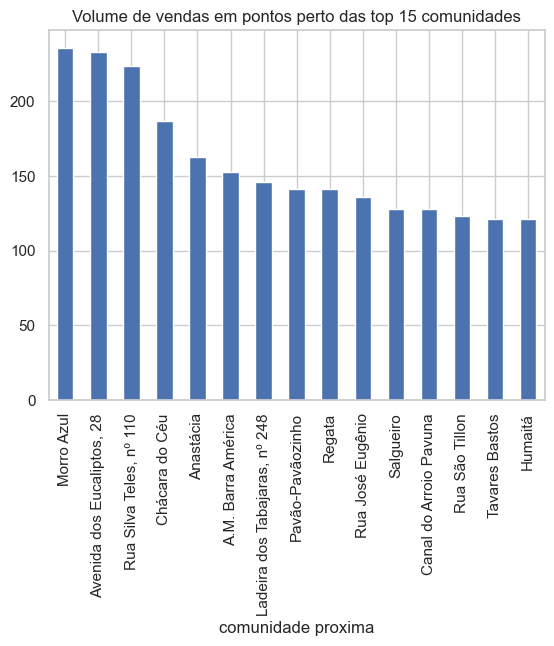

In [72]:
# Faça um gráfico de barras com o volume de vendas das top 15 comunidade
df_rj_filtered['comunidade proxima'].value_counts().head(15).plot(kind='bar')
plt.title('Volume de vendas em pontos perto das top 15 comunidades')
plt.show()

O custo do frete não diferem significativamente entre as vendas em pontos perto das comunidades e as vendas longe das comunidades

In [45]:
# Comparar o frete médio de vendas para os produtos que são vendidos perto de uma comunidade e os que não são
print("Comparação do Frete Médio perto das comunidades")
df_rj_filtered.groupby('perto da comunidade')['freight_value'].mean()


Comparação do Frete Médio perto das comunidades


perto da comunidade
Não    20.488360
Sim    21.119997
Name: freight_value, dtype: float64

In [46]:
# Comparar o frete médio de vendas para os produtos que são vendidos perto de uma comunidade e os que não são. Considerar somente as vendas de SP
print("Comparação do Frete Médio perto das comunidades das compras de SP")
df_rj_filtered[df_rj_filtered['seller_state'] == 'SP'].groupby('perto da comunidade')['freight_value'].mean()


Comparação do Frete Médio perto das comunidades das compras de SP


perto da comunidade
Não    20.001572
Sim    20.805831
Name: freight_value, dtype: float64

O custo médio do frete das vendas em pontos perto das comunidades no RJ é quase a metade de SP

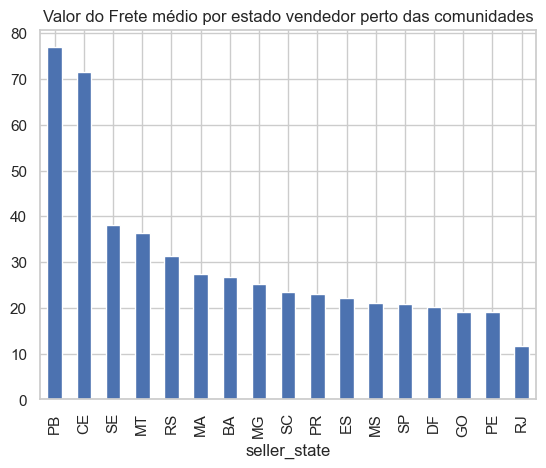

In [47]:
# Fazer um gráfico do review médio por estado vendedor para as vendas perto das comunidades e ordernar da maior para a menor média
df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Sim'].groupby('seller_state')['freight_value'].mean().sort_values(ascending=False).plot(kind='bar')
plt.title('Valor do Frete médio por estado vendedor perto das comunidades')
plt.show()

O review médio não diferente significativamente entre as vendas perto das comunidades e as vendas longe das comunidades

In [48]:
# Comparar o review médio de vendas para os produtos que são vendidos perto de uma comunidade e os que não são
print("Comparação do Review Médio perto das comunidades")
df_rj_filtered.groupby('perto da comunidade')['review_score'].mean()

Comparação do Review Médio perto das comunidades


perto da comunidade
Não    3.846752
Sim    3.841363
Name: review_score, dtype: float64

In [49]:
# Comparar o review médio de vendas para os produtos que são vendidos perto de uma comunidade e os que não são
print("Comparação do Review Médio perto das comunidades das compras de SP")
df_rj_filtered[df_rj_filtered['seller_state'] == 'SP'].groupby('perto da comunidade')['review_score'].mean()

Comparação do Review Médio perto das comunidades das compras de SP


perto da comunidade
Não    3.758764
Sim    3.741030
Name: review_score, dtype: float64

O % de notas 1 não difere significativamente entre as vendas perto das comunidades e as vendas longe das comunidades

In [50]:
# Quantas reviews de nota 1 foram feitas para produtos vendidos perto de uma comunidade?
print("Quantidade de reviews de nota 1 perto das comunidades")
df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Sim']['review_score'].value_counts()/df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Sim']['review_score'].value_counts().sum()*100


Quantidade de reviews de nota 1 perto das comunidades


review_score
5    54.085707
1    18.232632
4    16.289593
3     7.532606
2     3.859462
Name: count, dtype: float64

In [51]:
# Quantas reviews de nota 1 foram feitas para produtos vendidos perto de uma comunidade e quantos fora?
print("Quantidade de reviews de nota 1 perto das comunidades")
df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Não']['review_score'].value_counts()/df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Não']['review_score'].value_counts().sum()*100

Quantidade de reviews de nota 1 perto das comunidades


review_score
5    54.025618
1    17.817932
4    16.514181
3     7.387923
2     4.254346
Name: count, dtype: float64

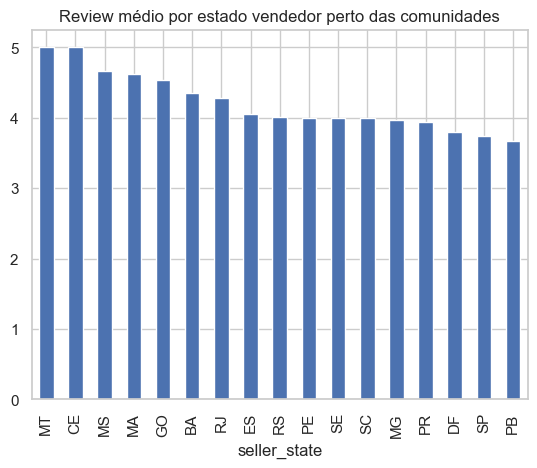

In [52]:
# Fazer um gráfico do review médio por estado vendedor para as vendas perto das comunidades e ordernar da maior para a menor média
df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Sim'].groupby('seller_state')['review_score'].mean().sort_values(ascending=False).plot(kind='bar')
plt.title('Review médio por estado vendedor perto das comunidades')
plt.show()

O tempo médio de entrega dos vendedores do RJ é quase 3 vezes menor do que o tempo médio de entrega dos vendedores de SP

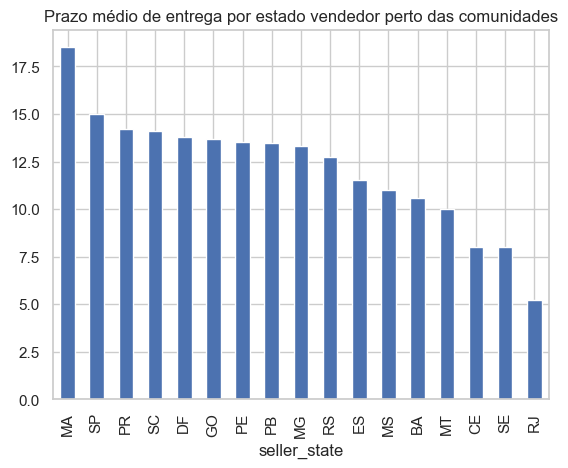

In [53]:
# Fazer um gráfico com o prazo médio de entrega por estado vendedor para as vendas perto das comunidades e ordernar da maior para a menor média
df_rj_filtered[df_rj_filtered['perto da comunidade'] == 'Sim'].groupby('seller_state')['prazo_realizado'].mean().sort_values(ascending=False).plot(kind='bar')
plt.title('Prazo médio de entrega por estado vendedor perto das comunidades')

plt.show()

In [54]:
# Comparar o review médio de vendas para os produtos que são vendidos perto de uma comunidade e os que não são
print("Comparação do Tempo Médio de Entrega perto das comunidades das compras de SP")
df_rj_filtered[df_rj_filtered['seller_state'] == 'SP'].groupby('perto da comunidade')['prazo_realizado'].mean()

Comparação do Tempo Médio de Entrega perto das comunidades das compras de SP


perto da comunidade
Não    14.624910
Sim    15.009237
Name: prazo_realizado, dtype: float64

#### 6.3 Análise das Compras realizadas nas DENTRO das comunidades do RJ

São Paulo é o estado que mais vende para as comunidades do RJ (70% das vendas)

In [61]:
# Quais são os 5 top mais estados que vendem para as comunidades?
top_5_estados_comunidades = df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Sim']['seller_state'].value_counts().head(5)/df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Sim']['seller_state'].value_counts().sum()*100
top_5_estados_comunidades

seller_state
SP    70.089286
MG     9.375000
PR     7.589286
RJ     6.696429
SC     1.785714
Name: count, dtype: float64

2% das vendas no RJ são em comunidades

In [65]:
# Quanto representa em % as vendas para as comunidades em relação ao total de vendas?
percentual_vendas_comunidades = df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Sim']['payment_value'].sum() / df_rj_filtered['payment_value'].sum() * 100
percentual_vendas_comunidades


2.070277837957098

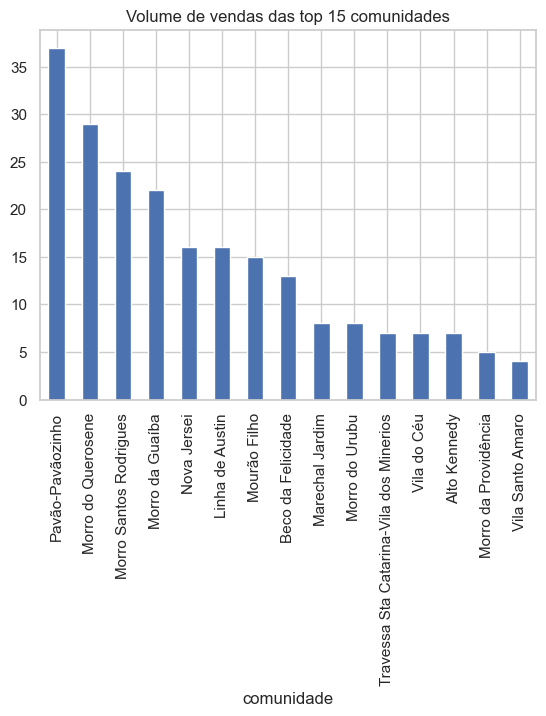

In [80]:
# Faça um gráfico de barras com o volume de vendas das top 15 comunidade. Excluir do grafico "fora da comunidade"
df_rj_filtered[df_rj_filtered['comunidade'] != 'Fora da comunidade']['comunidade'].value_counts().head(15).plot(kind='bar')
plt.title('Volume de vendas das top 15 comunidades')
plt.show()

O custo do frete é 3 reais maior entre as vendas nas comunidades e as vendas fora das comunidades

In [75]:
# Comparar o frete médio de vendas para os produtos que são vendidos na comunidade e os que não são
print("Comparação do Frete Médio para comunidades")
df_rj_filtered.groupby('dentro da comunidade')['freight_value'].mean()


Comparação do Frete Médio para comunidades


dentro da comunidade
Não    20.708152
Sim    23.325893
Name: freight_value, dtype: float64

In [76]:
# Comparar o frete médio de vendas para os produtos que são vendidos na comunidade e os que não são. Considerar somente as vendas de SP
print("Comparação do Frete Médio para comunidades das compras de SP")
df_rj_filtered[df_rj_filtered['seller_state'] == 'SP'].groupby('dentro da comunidade')['freight_value'].mean()


Comparação do Frete Médio para comunidades das compras de SP


dentro da comunidade
Não    20.291668
Sim    23.365223
Name: freight_value, dtype: float64

O custo médio do frete no RJ é a metade de SP

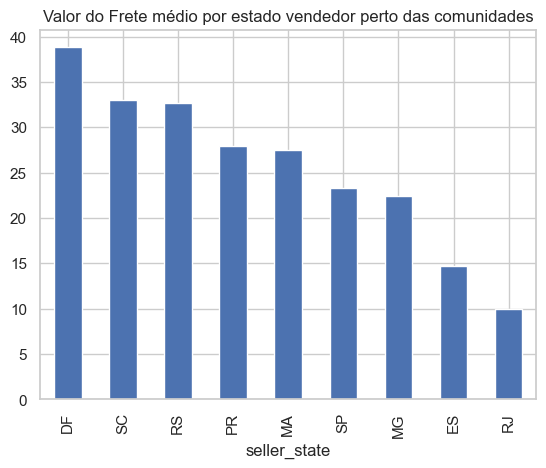

In [77]:
# Fazer um gráfico do review médio por estado vendedor para as vendas nas comunidades e ordernar da maior para a menor média
df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Sim'].groupby('seller_state')['freight_value'].mean().sort_values(ascending=False).plot(kind='bar')
plt.title('Valor do Frete médio por estado vendedor perto das comunidades')
plt.show()

O review médio das vendas nas comunidades é menor do que fora das comunidades

In [81]:
# Comparar o review médio de vendas para os produtos que são vendidos na comunidade e os que não são
print("Comparação do Review Médio perto das comunidades")
df_rj_filtered.groupby('dentro da comunidade')['review_score'].mean()

Comparação do Review Médio perto das comunidades


dentro da comunidade
Não    3.855661
Sim    3.441964
Name: review_score, dtype: float64

In [83]:
# Comparar o review médio de vendas para os produtos que são vendidos na comunidade e os que não são
print("Comparação do Review Médio perto das comunidades das compras de SP")
df_rj_filtered[df_rj_filtered['seller_state'] == 'SP'].groupby('dentro da comunidade')['review_score'].mean()

Comparação do Review Médio perto das comunidades das compras de SP


dentro da comunidade
Não    3.760779
Sim    3.401274
Name: review_score, dtype: float64

O % de notas 1 das vendas nas comunidades é maior do que das vendas fora das comunidades

In [85]:
# Quantas reviews de nota 1 foram feitas para produtos vendidos na comunidade?
print("Quantidade de reviews de nota 1 nas comunidades")
df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Sim']['review_score'].value_counts()/df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Sim']['review_score'].value_counts().sum()*100


Quantidade de reviews de nota 1 nas comunidades


review_score
5    43.303571
1    28.125000
4    15.625000
3    11.160714
2     1.785714
Name: count, dtype: float64

In [86]:
# Quantas reviews de nota 1 foram feitas para produtos vendidos na comunidade e quantos fora?
print("Quantidade de reviews de nota 1 perto das comunidades")
df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Não']['review_score'].value_counts()/df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Não']['review_score'].value_counts().sum()*100

Quantidade de reviews de nota 1 perto das comunidades


review_score
5    54.358001
1    17.722960
4    16.432638
3     7.349779
2     4.136622
Name: count, dtype: float64

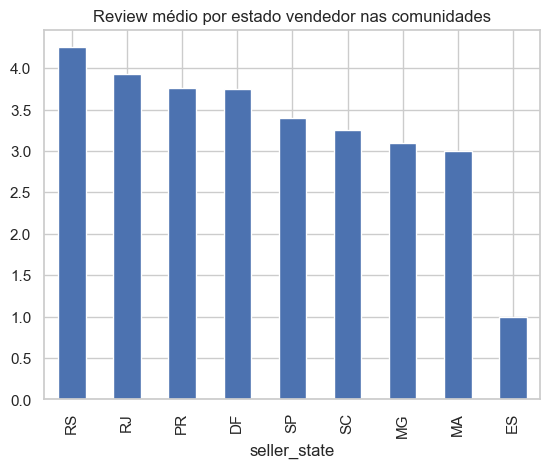

In [87]:
# Fazer um gráfico do review médio por estado vendedor para as vendas nas comunidades e ordernar da maior para a menor média
df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Sim'].groupby('seller_state')['review_score'].mean().sort_values(ascending=False).plot(kind='bar')
plt.title('Review médio por estado vendedor nas comunidades')
plt.show()

O tempo médio de entrega dos vendedores do RJ é 3 vezes menor do que o tempo médio de entrega dos vendedores de SP

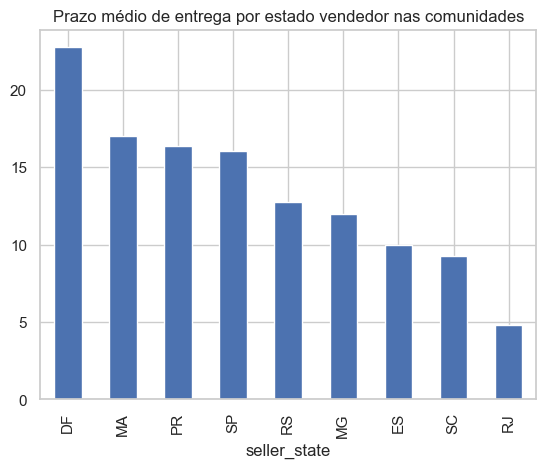

In [88]:
# Fazer um gráfico com o prazo médio de entrega por estado vendedor para as vendas perto das comunidades e ordernar da maior para a menor média
df_rj_filtered[df_rj_filtered['dentro da comunidade'] == 'Sim'].groupby('seller_state')['prazo_realizado'].mean().sort_values(ascending=False).plot(kind='bar')
plt.title('Prazo médio de entrega por estado vendedor nas comunidades')

plt.show()

In [89]:
# Comparar o review médio de vendas para os produtos que são vendidos na comunidade e os que não são
print("Comparação do Tempo Médio de Entrega nas comunidades das compras de SP")
df_rj_filtered[df_rj_filtered['seller_state'] == 'SP'].groupby('dentro da comunidade')['prazo_realizado'].mean()

Comparação do Tempo Médio de Entrega nas comunidades das compras de SP


dentro da comunidade
Não    14.768345
Sim    16.085526
Name: prazo_realizado, dtype: float64

# Definir critérios para avaliar a oportunidade de negócio nas comunidades do RJ: review menor, tamanho da comunidade, tem UPP